In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy
import cartopy.feature as cfeature
import cartopy.crs as ccrs
import h5py
from cartopy.io.img_tiles import GoogleTiles
import imageio
from PIL import Image

In [2]:
# Shaded relief map style
class ShadedReliefESRI(GoogleTiles):
    # shaded relief
    def _image_url(self, tile):
        x, y, z = tile
        url = ('https://server.arcgisonline.com/ArcGIS/rest/services/' \
               'World_Shaded_Relief/MapServer/tile/{z}/{y}/{x}.jpg').format(
               z=z, y=y, x=x)
        return url

In [3]:
# Open a text file with the file names, one per line
# Reads each file name to a list
with open('../data/sabancaya/so2-data/file-names.txt', 'r') as files:
    file_list = files.read().splitlines()

In [4]:
# Using h5py, open and read the h5 files to a list named 'dataset'
dataset = []
for file in file_list:
    try:
        h5_read = h5py.File('../data/sabancaya/so2-data/OMPS-NPP/' + file, 'r')
        dataset.append(h5_read)

    except:
        print(file)

In [5]:
def h5(file, key):
    '''
    Takes inputs file and key
    Reads from the h5 file type using the file name and the key values specified.
    Returns raw data
    '''
    data = list(file[key])
    return data

In [6]:
def process_list(key):
    '''
    Processes the raw data from the h5 file, returns as a list.
    '''
    data_raw = [h5(i, key) for i in dataset]
    data_ = [sum([list(ii) for ii in list(i)],[]) for i in data_raw]
    data = sum(data_, [])
    return data

In [7]:
# Latitude data points
lat = process_list('GEOLOCATION_DATA/Latitude')

# Longitude
lon = process_list('GEOLOCATION_DATA/Longitude')

# sulfur dioxide
so2 = process_list('SCIENCE_DATA/ColumnAmountSO2')

# date processing
date_raw = [h5(i, 'GEOLOCATION_DATA/UTC_CCSDS_A') for i in dataset]
date_ = [[ii.decode('UTF-8').split('T')[0]for ii in i] for i in date_raw]
date = sum([list(np.repeat(i,36)) for i in date_], [])

In [8]:
# Creates a pandas DataFrame from the variables processed from the dataset.
df = pd.DataFrame(zip(lat, lon, so2, date),
                 columns=['lat', 'lon', 'so2', 'date'])
df.head()

,lat,lon,so2,date
0,-68.622772,136.339279,-1.267651e+30,2015-01-01
1,-69.378525,131.454559,-1.267651e+30,2015-01-01
2,-69.777115,127.882202,-1.267651e+30,2015-01-01
3,-70.024307,124.774261,-1.267651e+30,2015-01-01
4,-70.167755,122.031914,-1.267651e+30,2015-01-01


In [9]:
# Latitude and Longitude of Vulcan Sabancaya
lon_sabancaya, lat_sabancaya = -71.857, -15.787

# Map Extents: longitude 1 + 2, latitude 1 + 2
extent = [-85.857, -66.857, -10.787, -21.79]

In [10]:
# Refine Dataframe to the map extents and any so2 values greater than 0.5 DU
df_sabancaya = df[(df.lon >= extent[0]) & (df.lon <= extent[1]) &
                    (df.lat >= extent[3]) & (df.lat <= extent[2]) &
                    (df.so2 > .25)]
df_sabancaya.head()

,lat,lon,so2,date
7382,-21.041908,-68.215233,0.766070,2015-01-01
7452,-21.366446,-71.450546,0.287163,2015-01-01
7454,-20.168394,-68.370827,0.371869,2015-01-01
7455,-19.790131,-67.307426,0.336452,2015-01-01
7488,-20.932653,-71.517746,0.344016,2015-01-01


In [11]:
# Create a list of unique dates and sort them
dates = list(set(list(df_sabancaya.date)))
dates.sort()

In [12]:
def plotting(df, date):
    '''
    Plotting fuction
    Parameters:
    df:
        Pandas DataFrame of data to be plotted

    date:
        Specific Date of the dataframe to plot

    png_name:
        name of the png to be save, integer value from 0-999 inclusive
    '''
    df_filtered = df[df['date'] == date]
    
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=ShadedReliefESRI().crs)
    ax.set_extent(extent)
    ax.add_feature(cfeature.OCEAN)
    ax.add_feature(cfeature.LAKES, edgecolor='black')
    ax.add_feature(cfeature.RIVERS)
    ax.coastlines()
    gl = ax.gridlines(draw_labels=True)
    gl.top_labels = False
    gl.right_labels = False
    cs = ax.scatter(df_filtered.lon, df_filtered.lat, c=df_filtered.so2,
               transform=ccrs.PlateCarree(), cmap='YlOrBr',
               vmin=0, vmax=3.5)
    ax.scatter(lon_sabancaya, lat_sabancaya, marker='^', color='k', transform=ccrs.PlateCarree())
    cax = fig.add_axes([.95, .25, .02, .5])
    cbar = plt.colorbar(cs, cax=cax, label=u'SO\u2082 [DU]')
    ax.add_image(ShadedReliefESRI(), 8)
    ax.set_title(f'Atmospheric Sulfur Dioxide {date}', fontsize=20)

    plt.savefig(f'../figures/png/{date}-so2.png', bbox_inches='tight')
    plt.show()

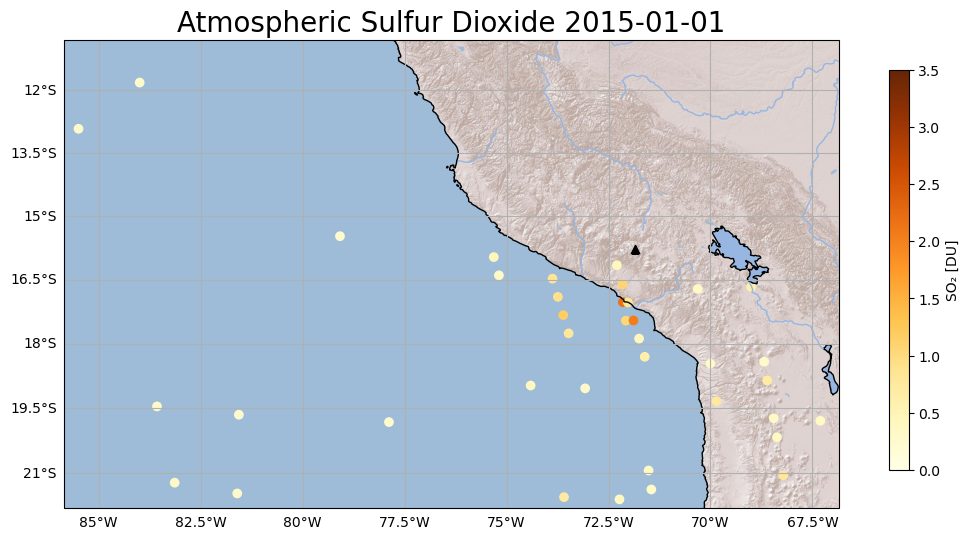

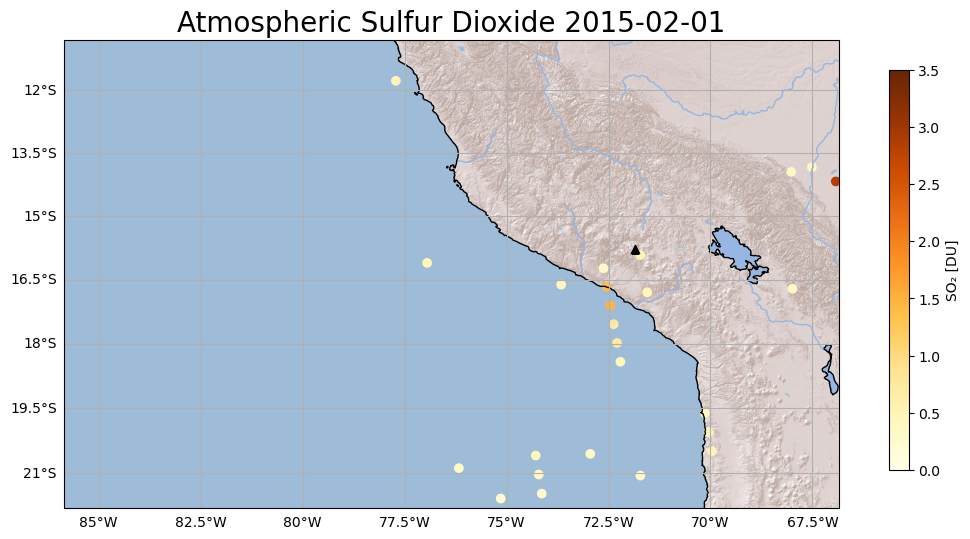

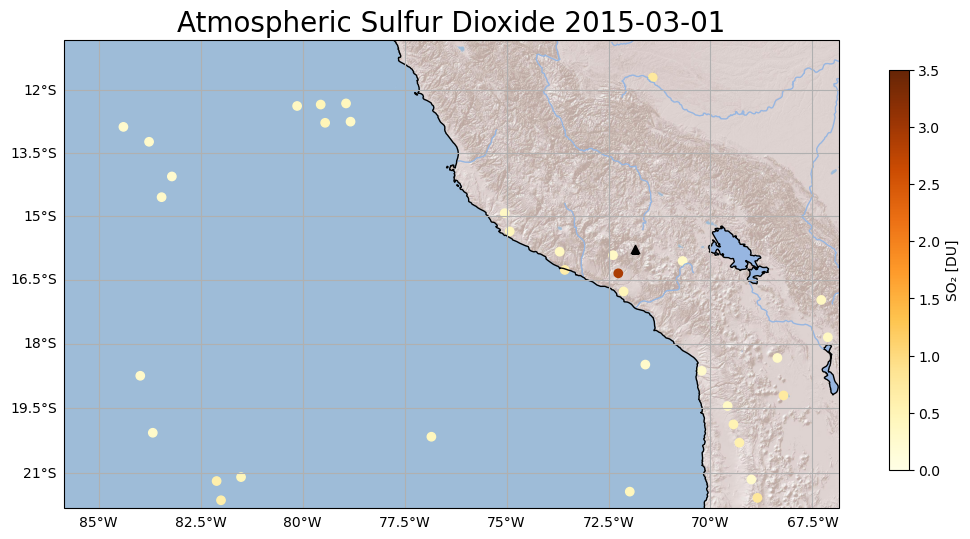

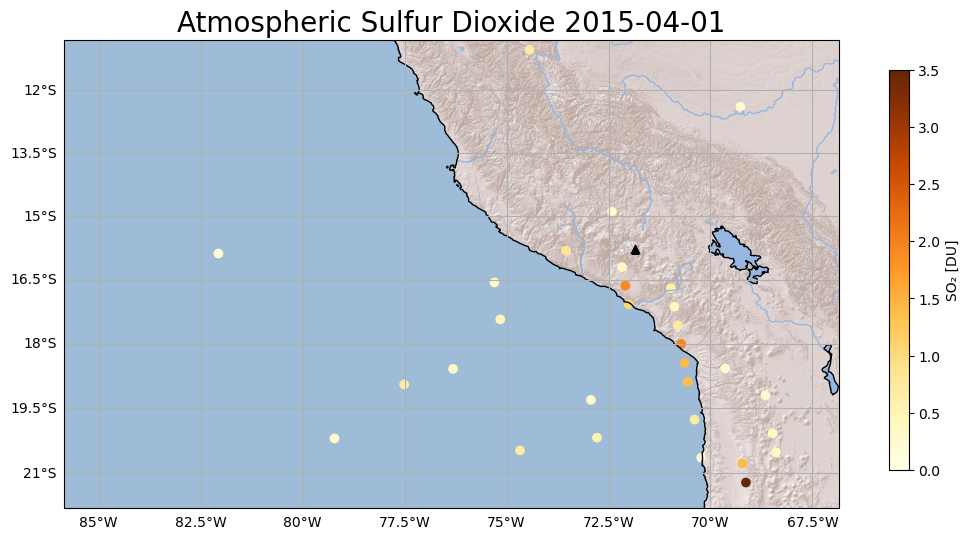

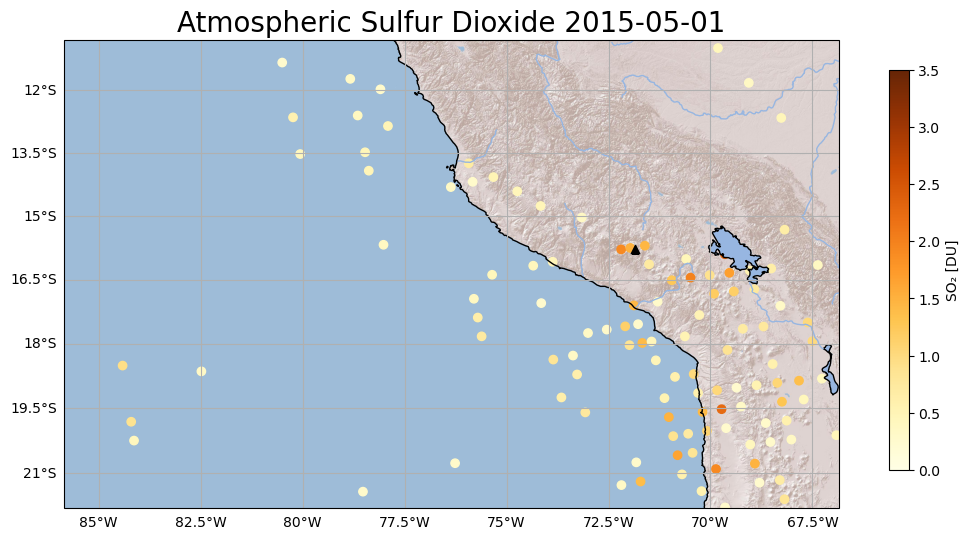

...

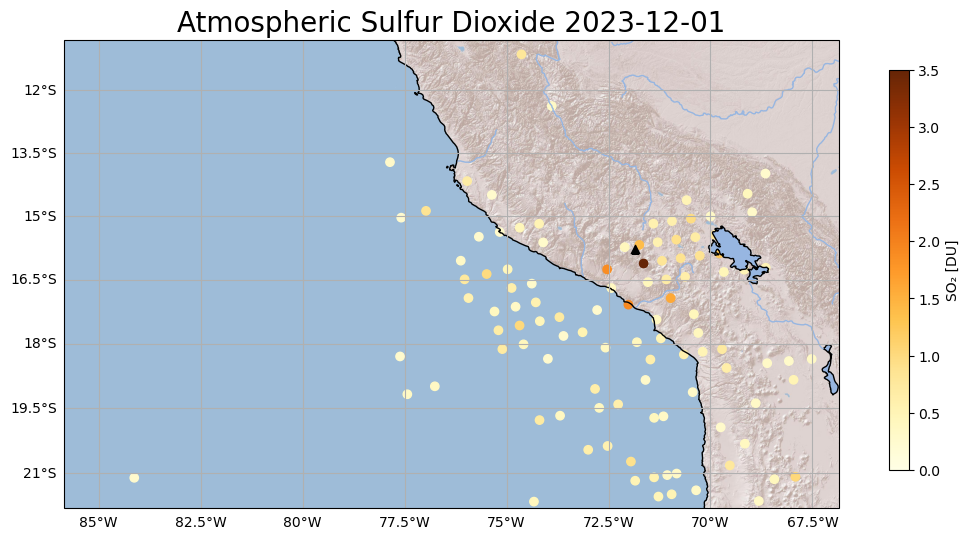

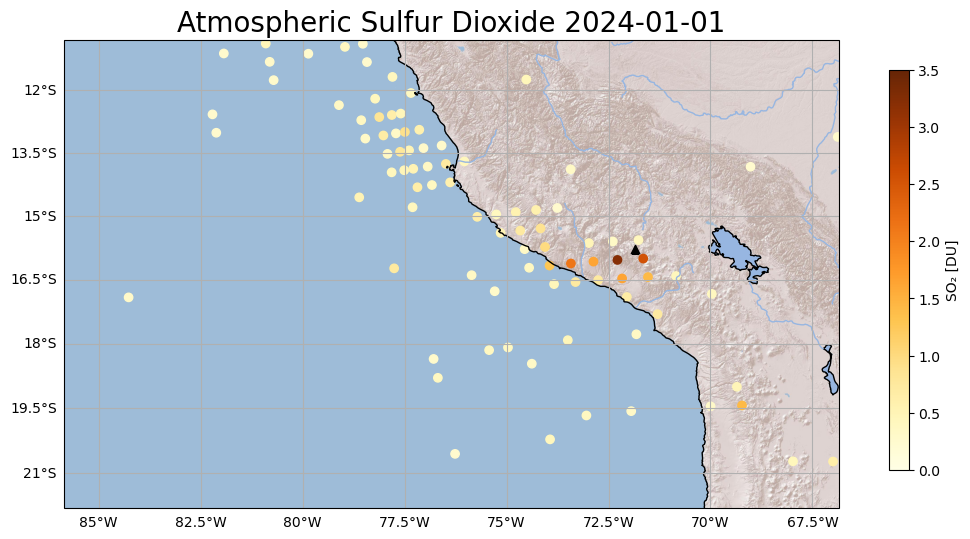

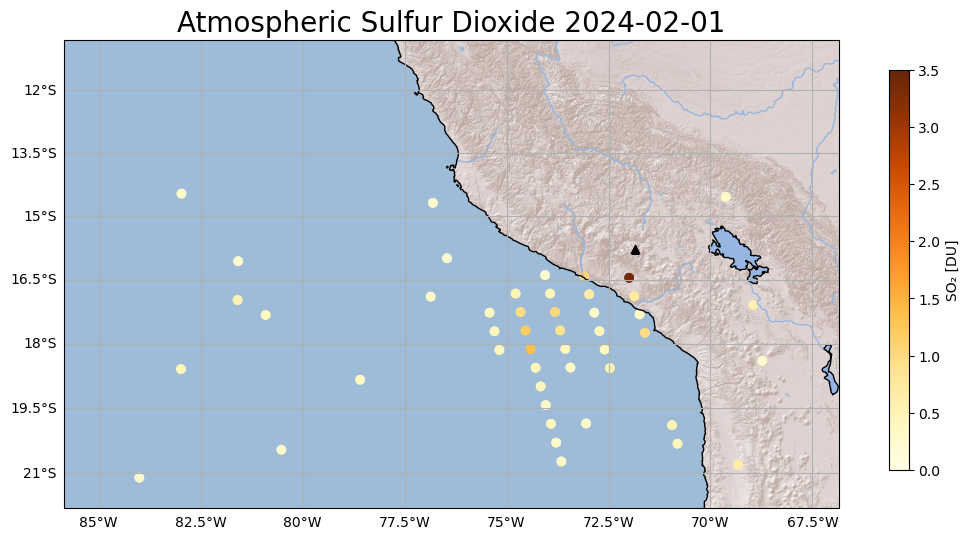

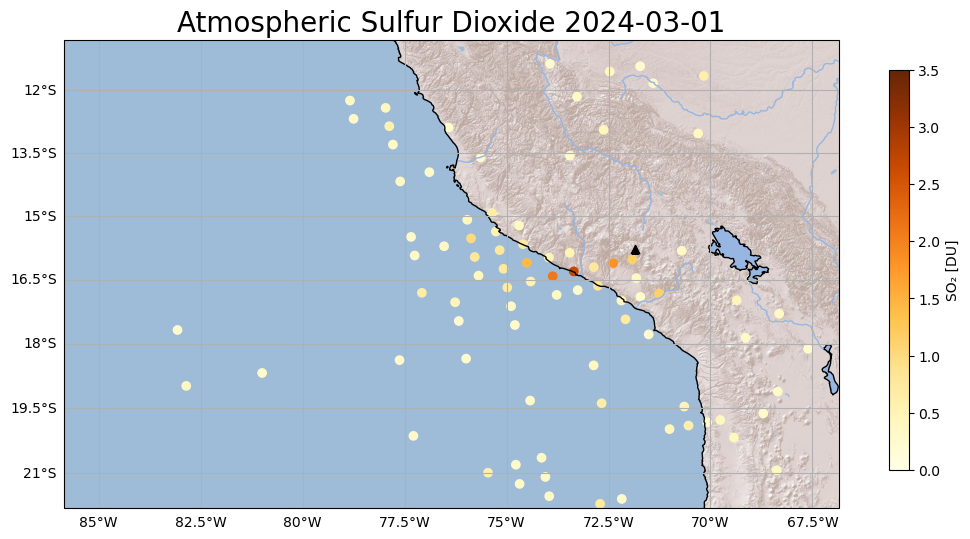

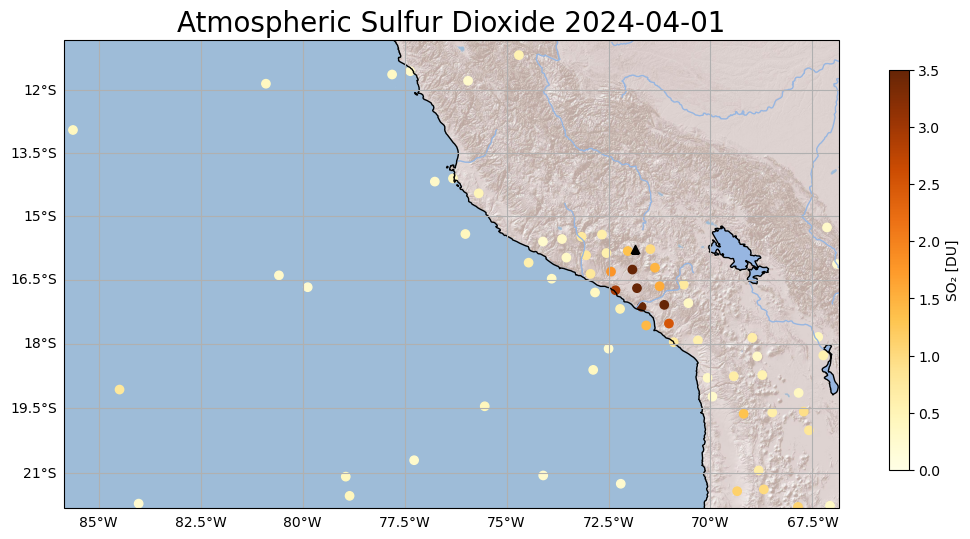

In [13]:
for date in dates:
    plotting(df_sabancaya, date)

In [15]:
images = []
for name in dates:
    image = Image.open(f'../figures/png/{name}-so2.png')
    images.append(image)

imageio.mimsave('../figures/so2_sabancaya.gif', images, duration=750)

In [13]:
df_monthly = df_sabancaya[['so2','date']].groupby('date').sum().reset_index()
df_monthly.head()

,date,so2
0,2015-01-01,22.602179
1,2015-02-01,15.188314
2,2015-03-01,17.868116
3,2015-04-01,27.022381
4,2015-05-01,82.537788


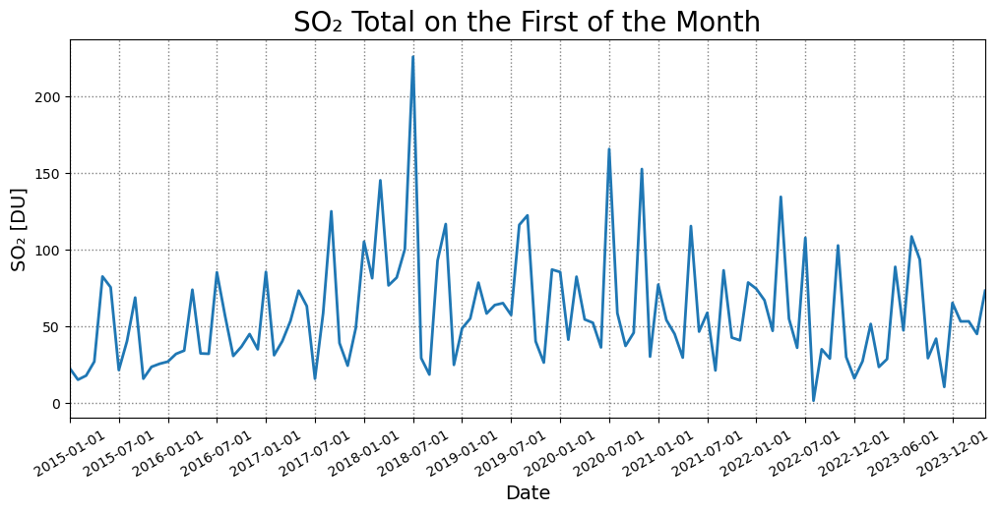

In [26]:
plt.figure(figsize=(12,5))
plt.plot(df_monthly['date'], df_monthly['so2'], lw=2)
plt.title(u'SO\u2082 Total on the First of the Month', fontsize=20)
plt.xlabel('Date', fontsize=14)
plt.ylabel(u'SO\u2082 [DU]', fontsize=14)
plt.xticks(df_monthly['date'][::6], rotation=30)
plt.xlim(df_monthly.date[0], df_monthly.date.iloc[-1])
plt.grid(color='gray', lw=1, ls='dotted')
plt.savefig('../figures/so2-monthly-total.png', bbox_inches='tight')
plt.show()